In [134]:
import numpy as np
import torch
import timm
import torchvision.transforms as transforms
from torch.autograd import Variable

import copy

import matplotlib.pyplot as plt

In [2]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [14]:
model = timm.create_model('resnet50', pretrained=True)
model.eval()
model.to(device)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (act1): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (act1): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (act2): ReLU(inplace=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (act3): ReLU(inplace=True)
      (downsample): Sequen

In [15]:
model.default_cfg

{'url': 'https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-weights/resnet50_ram-a26f946b.pth',
 'num_classes': 1000,
 'input_size': (3, 224, 224),
 'pool_size': (7, 7),
 'crop_pct': 0.875,
 'interpolation': 'bicubic',
 'mean': (0.485, 0.456, 0.406),
 'std': (0.229, 0.224, 0.225),
 'first_conv': 'conv1',
 'classifier': 'fc',
 'architecture': 'resnet50'}

In [148]:
def initialize_image(img_size, mean, std):
    img = np.uint8(np.random.uniform(150, 180, (224, 224, 3)))
    transform = transforms.Compose([
          transforms.ToTensor(),
            transforms.Normalize(mean, std)
    ])
    return transform(img).unsqueeze(0).requires_grad_(True)

def visualize_filter(model, filter_index, device, verbose=False, **kwargs):
    iterations = kwargs.get('iteration',30)
    learning_rate = kwargs.get('learning_rate',0.1)
    eval_every = kwargs.get('eval_every',10)
    
    # activation
    activation_dict = {}
    def get_activation(name):
        def hook(model, input, output):            
            activation_dict[name] = output
        return hook    
    
    model.layer3.register_forward_hook(get_activation('output'))
    
    # processed image
    img = initialize_image(img_size=model.default_cfg['input_size'],
                                 mean=model.default_cfg['mean'],
                                 std=model.default_cfg['std'])
    # optimizer
    optimizer = torch.optim.Adam([img], lr=learning_rate, weight_decay=1e-6)
    
    for iteration in range(iterations):
        optimizer.zero_grad()
        
        output = model(img.to(device))
    
        activation = activation_dict['output'][:, filter_index]
        loss = -activation.mean()
        
        # compute gradients
        loss.backward()
        
        if iteration % eval_every == 0 and verbose:
            print('loss: ',loss.item())
        
        optimizer.step()
        
    img = deprocess_image(img[0].detach().cpu().numpy(),
                          mean=model.default_cfg['mean'],
                          std=model.default_cfg['std'])
    
    return img

def deprocess_image(img, mean, std):
    # Normalize array: center on 0., ensure variance is 0.15
    mean = np.expand_dims(mean, axis=[1,2])
    std = np.expand_dims(std, axis=[1,2])
    img = (img*std) + mean

    img = np.clip(img, 0, 1)
    
    img = np.round(img*255).astype(np.uint8)
    return np.transpose(img, axes=[1,2,0])

loss:  -0.05781206116080284
loss:  -11.6500244140625
loss:  -19.602794647216797
loss:  -24.116601943969727
loss:  -27.23765754699707
loss:  -29.536909103393555
loss:  -31.371845245361328
loss:  -32.875213623046875
loss:  -34.18687057495117
loss:  -35.21078109741211


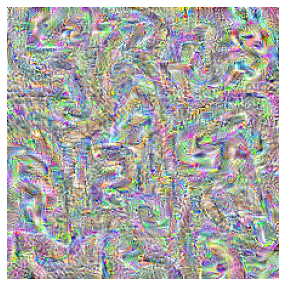

In [161]:
image = visualize_filter(model, 1, device=device, verbose=True, learning_rate=0.1, eval_every=10, iteration=100)

plt.figure(figsize=(5,5))
plt.imshow(image)
plt.axis('off')
plt.show()

In [162]:
# Compute image inputs that maximize per-filter activations
# for the first 64 filters of our target layer

def stack_64filters(learning_rate=0.1, iteration=30):
    f, ax = plt.subplots(8,8, figsize=(40,40))
    for filter_index in range(64):
        img = visualize_filter(model, filter_index, device, 
                               learning_rate=learning_rate, iteration=iteration)
        ax[filter_index//8, filter_index%8].imshow(img)
        ax[filter_index//8, filter_index%8].axis('off')

    plt.tight_layout()
    plt.show()

# Layer 3

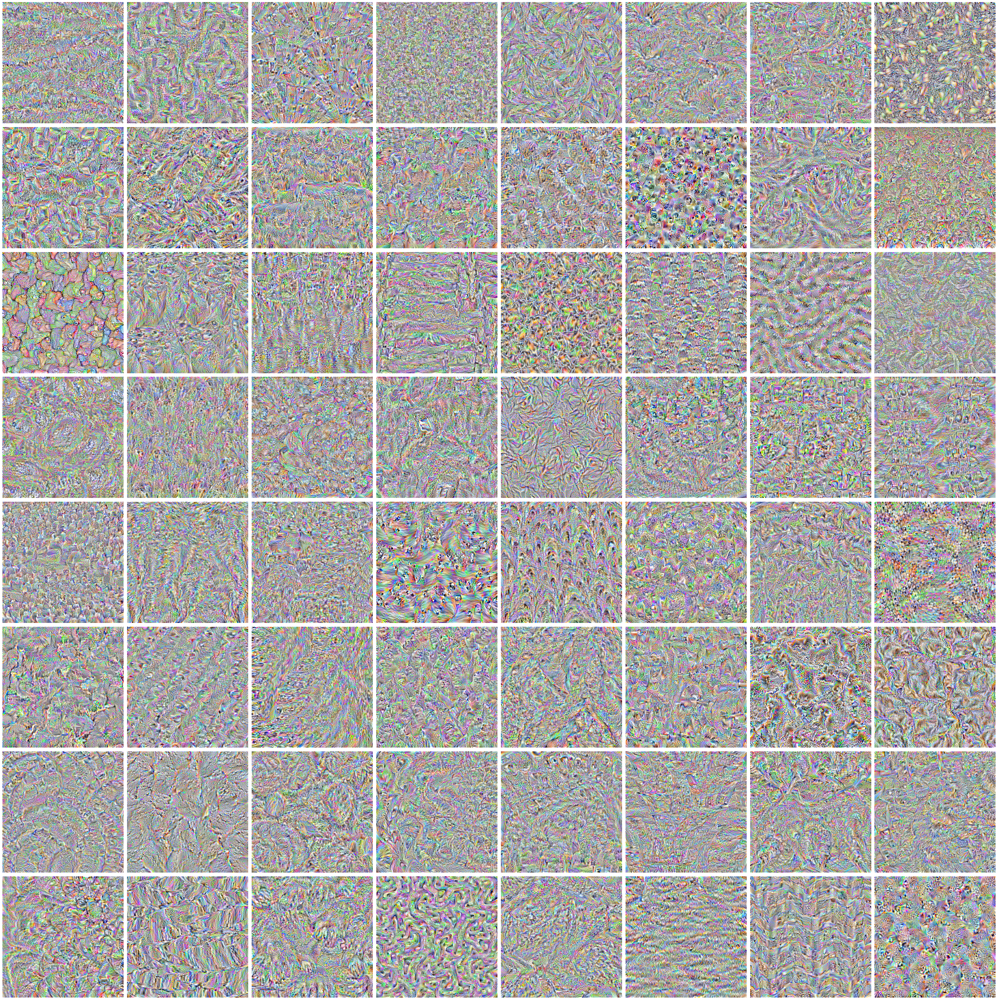

In [163]:
stack_64filters(learning_rate=0.1, iteration=100)